In [1]:
import sys
sys.path.append("../..")
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import beta, uniform
import pandas as pd
from library import *
from scipy.integrate import quad

n_samples = 1000
n_runs = 100
a, b = 0, 1
N_VARIANCES = 500

In [2]:
methods = [
    direct_sampling,
    control_variates,
    importance_sampling,
    stratified_sampling,
    antithetic_sampling
]

f = lambda x: x**2

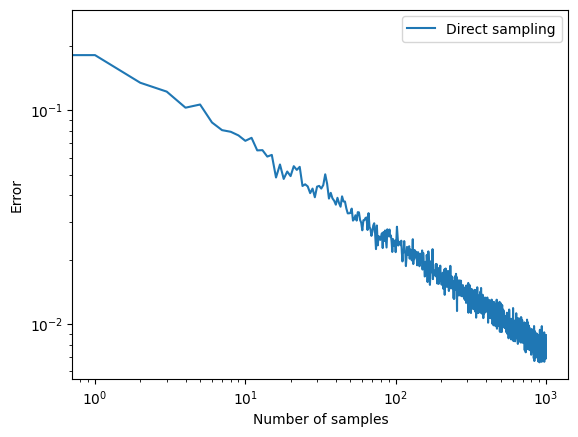

(500,)
Variance for n=1000 samples: 0.09045277512053848


In [3]:
# Direct sampling
error_direct = np.zeros(n_samples)
variances = np.zeros(n_samples)
for i in range(n_runs):
    for n in range(1, n_samples + 1):
        y = direct_sampling(f, 0, 1, n)
        error_direct[n - 1] += np.abs(y - 1 / 3)
error_direct /= n_runs
    
plt.loglog(error_direct, label='Direct sampling')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Compute of the variance for n=100 samples
variances_direct = np.array([direct_sampling(f, a, b, 1000) for _ in range(N_VARIANCES)])
print(variances_direct.shape)
variance_direct = np.var(variances_direct) * 1000
print('Variance for n=1000 samples:', variance_direct)


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


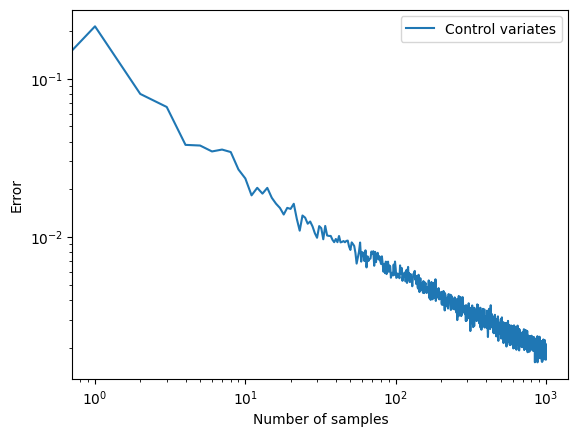

(500,)
Variance of variance control technique: 0.005395116056231583


In [4]:
# Control variates
error_control = np.zeros(n_samples, dtype=float)
variances = np.zeros(n_samples, dtype=float)
for n in range(2, n_samples + 1):
    means = []
    for i in range(n_runs):
        y = control_variates(f, 0, 1, n)
        error_control[n - 1] += np.abs(y - 1 / 3)
    variances[n-1] = np.var(means)
error_control /= n_runs

# Plot the results
plt.loglog(error_control, label='Control variates')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Compute of the variance for n=100 samples
variance_control = np.array([control_variates(f, a, b, 1000) for _ in range(N_VARIANCES)])
print(variance_control.shape)
variance_control = np.var(variance_control) * 1000
print('Variance of variance control technique:', variance_control)

In [5]:
# Importance sampling
error_importance = np.zeros(n_samples, dtype=float)
alfa, betax = 2.9, 1

variances = np.zeros(n_samples, dtype=float)
for n in range(1, n_samples + 1):
    means = []
    for i in range(n_runs):
        x = beta.rvs(alfa, betax, size=n)
        y = x ** 2 / beta.pdf(x, alfa, betax)
        error_importance[n - 1] += np.abs(np.mean(y) - 1 / 3)
        means.append(np.mean(y))
    variances[n-1] = np.var(means)
error_importance /= n_runs

# Plot the results
plt.loglog(error_importance, label='Importance sampling')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Compute of the variance with this method
means = []
for i in range(N_VARIANCES):
    x = beta.rvs(alfa, betax, size=1000)
    y = x ** 2 / beta.pdf(x, alfa, betax)
    means.append(np.mean(y))
var_importance = np.var(means)*1000
print('Variance of the importance sampling method: ', var_importance)

[0.33983283]
[0.32936847]
[0.34148878]
[0.32834235]
[0.33574509]
[0.34142284]
[0.32922495]
[0.31830566]
[0.32815967]
[0.33848357]
[0.34447495]
[0.33766724]
[0.34277897]
[0.33262039]
[0.33457108]
[0.34176754]
[0.34281132]
[0.33980179]
[0.33882294]
[0.34427628]
[0.33915524]
[0.33645907]
[0.33068214]
[0.34340488]
[0.34173523]
[0.32298456]
[0.33266219]
[0.32637935]
[0.3366526]
[0.34260395]
[0.34259643]
[0.34448793]
[0.33820981]
[0.29723348]
[0.33810809]
[0.33909556]
[0.33081734]
[0.3357542]
[0.30334148]
[0.33798864]
[0.34444375]
[0.33857046]
[0.33152458]
[0.34216951]
[0.33952034]
[0.33855368]
[0.30790566]
[0.34268894]
[0.34125678]
[0.32599838]
[0.33264946]
[0.31258286]
[0.34081096]
[0.32339328]
[0.34463509]
[0.32914803]
[0.34233429]
[0.34348362]
[0.34466705]
[0.34389369]
[0.34254277]
[0.33448867]
[0.33328125]
[0.34061872]
[0.32878133]
[0.34021816]
[0.34321348]
[0.33943665]
[0.34408189]
[0.34163741]
[0.34419161]
[0.33332155]
[0.30681943]
[0.33346467]
[0.33624343]
[0.34404512]
[0.33664954]
[

KeyboardInterrupt: 

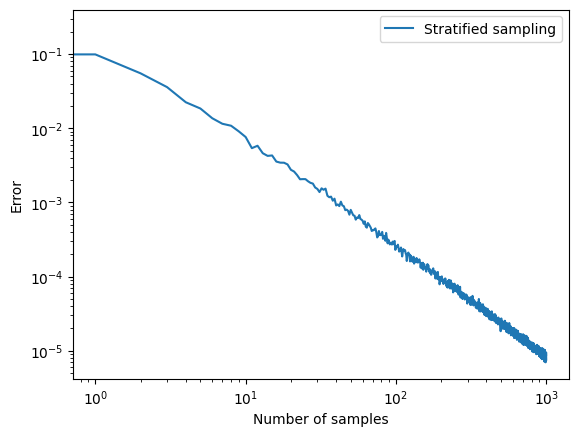

(500,)
Variance of the stratified sampling method:  1.104307169498503e-07


In [ ]:
# Stratified sampling
error_stratified = np.zeros(n_samples, dtype=float)
variances = np.zeros(n_samples, dtype=float)
for n in range(1, n_samples + 1):
    means = []
    for i in range(n_runs):
        y = stratified_sampling(f, 0, 1, n)
        error_stratified[n - 1] += np.abs(y - 1 / 3)
        means.append(y)
    variances[n-1] = np.var(means)
error_stratified /= n_runs

# Plot the results
plt.loglog(error_stratified, label='Stratified sampling')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Compute of the variance with this method
variances_stratified = np.array([stratified_sampling(f, a, b, 1000) for _ in range(N_VARIANCES)])
print(variances_stratified.shape)
variance_stratified = np.var(variances_stratified) * 1000
print('Variance of the stratified sampling method: ', variance_stratified)

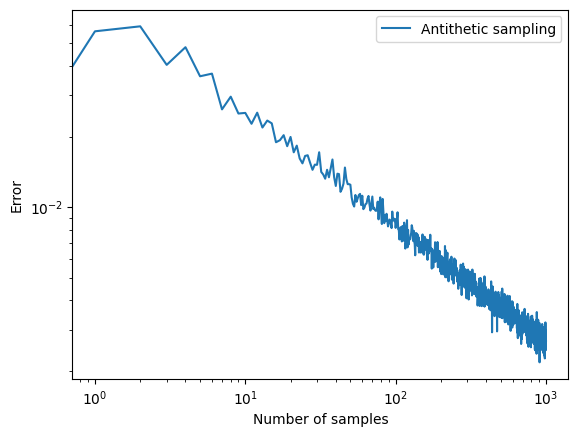

(500,)
Variance of the antithetic sampling method:  0.011906210940712314


In [ ]:
# Antithetic sampling
error_antithetic = np.zeros(n_samples, dtype=float)
for i in range(n_runs):
    for n in range(2, n_samples + 1):
        y = antithetic_sampling(f, a, b, n)
        error_antithetic[n - 1] += np.abs(y - 1 / 3)
error_antithetic /= n_runs

# Plot the results
plt.loglog(error_antithetic, label='Antithetic sampling')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Compute of the variance with this method
variances_antithetic = np.array([antithetic_sampling(f, a, b, 1000) for _ in range(N_VARIANCES)])
print(variances_antithetic.shape)
variance_antithetic = np.var(variances_antithetic) * 1000
print('Variance of the antithetic sampling method: ', variance_antithetic)


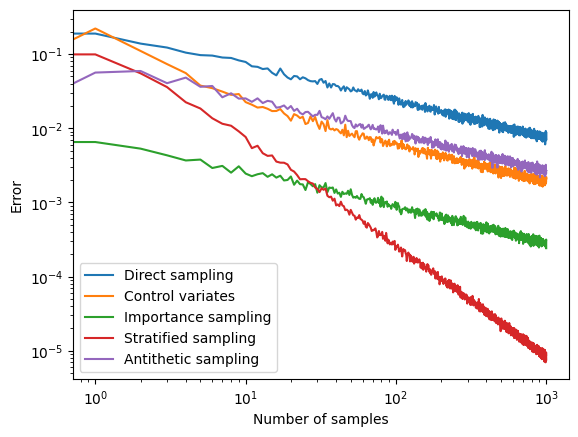

Variance each method: 


,Variance
Direct,9.826291e-02
Control,6.557070e-03
Importance,1.223206e-04
Stratified,1.104307e-07
Antithetic,1.190621e-02


In [ ]:
# Plot the results
plt.loglog(error_direct, label='Direct sampling')
plt.loglog(error_control, label='Control variates')
plt.loglog(error_importance, label='Importance sampling')
plt.loglog(error_stratified, label='Stratified sampling')
plt.loglog(error_antithetic, label='Antithetic sampling')
plt.legend()
plt.xlabel('Number of samples')
plt.ylabel('Error')
plt.show()

# Create a table with the variance and mean of each method
variances = [variance_direct, variance_control, var_importance, variance_stratified, variance_antithetic]

table = np.zeros((5, 1))
table[:, 0] = variances
print('Variance each method: ')
pd.DataFrame(table, columns=['Variance'], index=['Direct', 'Control', 'Importance', 'Stratified', 'Antithetic'])


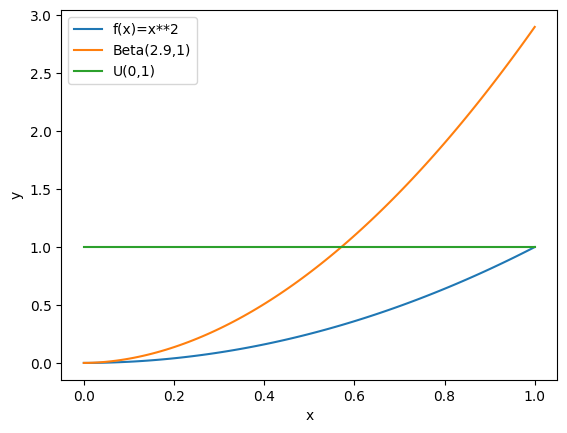

In [ ]:
# Plot of Beta(4,2) and y=x**2
x = np.linspace(0, 1, 100)
y = x ** 2
plt.plot(x, y, label='f(x)=x**2')
plt.plot(x, beta.pdf(x, 2.9, 1), label='Beta(2.9,1)')
plt.plot(x, uniform.pdf(x,0,1), label='U(0,1)')
plt.legend()
plt.xlabel('x')
plt.ylabel('y')
plt.show()